# Welcome To The Notebook
In this project, I will be using using python and folium to analyze Geo-spatial data from Porto, Portugal.


#### Import modules and data


In [17]:
import pandas as pd 
import datetime , calendar
import folium

In [18]:
data = pd.read_csv('dataset.csv')
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499..."
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351..."
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)..."
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705..."
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)..."


### Let's talk about the different columns
---
- CALL_TYPE: The way used to demand taxi service
    - 'A' : if this trip was dispatched from the central
    - 'B' : if this trip was demanded directly to a taxi driver on a specific stand 
    - 'C' : other (i.e. a trip demanded on a random street)

- TIMESTAMP: When the trip starts 

- TRIP_PATH: Contains a list of coordinates
    - The first element is the coordinates of the trip's starting point
    - The last element is the coordinates of the trip's end point

### Data Preprocessing 
Let's extract starting and ending points of each trip <br>

    - Creating two columns START_LOC and END_LOC

In [19]:
data.TRIP_PATH = data.TRIP_PATH.apply(eval)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499..."
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351..."
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)..."
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705..."
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)..."


In [20]:
extract_starting_point = lambda list_: list_[0]
extract_ending_point = lambda list_: list_[-1]
data['START_LOC'] = data.TRIP_PATH.apply(extract_starting_point)
data['END_LOC'] = data.TRIP_PATH.apply(extract_ending_point)

data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,C,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,B,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,C,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,C,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,C,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


Remapping CALL_TYPE column values to the proper values

In [21]:
CALL_TYPES = {
              "A":"CENTRAL_BASED",
              "B":"STAND_BASED",
              "C":"OTHER"
             }

data.CALL_TYPE = data.CALL_TYPE.apply(lambda row: CALL_TYPES[row])

data.head()



,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


### Data Analysis 
Let's answer to some analytical questions using our data 
 
 

### Question 1 - What are the most common ways to get a taxi in Porto?

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

<AxesSubplot:>

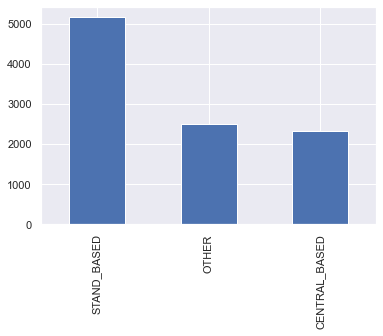

In [26]:
q1_data = data.CALL_TYPE.value_counts()
q1_data.plot.bar(grid=True)


### Question 2 - Which regions of the city are the best pick up points?

Load a map with location markers

In [34]:
Map = folium.Map(location = [41.15, -8.62], zoom_start = 14)

for point in data.START_LOC:
    folium.CircleMarker(location=point, color='red', radius=1, weight=2).add_to(Map)
Map

### Question 3 - Which regions of the city are the best pick up points for stand-based trips?

Can create points on the map for each CALL_TYPE

In [35]:
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)"
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)"
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)"
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)"
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)"


In [38]:
Map2 = folium.Map(location=[41.15, -8.62], zoom_start=14)

colors = {
    'OTHER':'purple', 
    'STAND_BASED':'red', 
    'CENTRAL_BASED':'blue'
}

Q3_data = data[['CALL_TYPE', 'START_LOC']]
for index, row in Q3_data.iterrows():
    color = colors[row['CALL_TYPE']]
    point = row['START_LOC']
    location = row['START_LOC']
    folium.CircleMarker(location, color=color, radius=1, weight=2).add_to(Map2)

Map2

### Question 4 - Which regions of the city are the most common destinations on Mondays? 

Will use datetime and the TIMESTAMP column

In [42]:
day_names = list(calendar.day_name)

In [44]:
get_day = lambda timestamp: day_names[datetime.datetime.fromtimestamp(timestamp).weekday()]
data['week_day'] = data.TIMESTAMP.apply(get_day)
data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,week_day
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)",Sunday
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)",Sunday
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)",Sunday
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)",Sunday
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)",Sunday


Let's get all the trips on Mondays 

In [46]:
monday_data = data[data.week_day == 'Monday']
monday_data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,week_day
220,1372651639620000517,CENTRAL_BASED,1372651639,"[(41.164632, -8.583048), (41.164173, -8.582679...","(41.164632, -8.583048)","(41.148855, -8.585604)",Monday
236,1372651473620000454,CENTRAL_BASED,1372651473,"[(41.158269, -8.638272), (41.158278, -8.638263...","(41.158269, -8.638272)","(41.148864, -8.585631)",Monday
240,1372653466620000403,STAND_BASED,1372653466,"[(41.15187, -8.62704)]","(41.15187, -8.62704)","(41.15187, -8.62704)",Monday
241,1372652617620000477,OTHER,1372652617,"[(41.15115, -8.6148), (41.151348, -8.614728), ...","(41.15115, -8.6148)","(41.237523, -8.67024)",Monday
242,1372652978620000167,CENTRAL_BASED,1372652978,"[(41.155389, -8.677953), (41.155389, -8.677962...","(41.155389, -8.677953)","(41.1462, -8.617698)",Monday


Visualize the data on the map

In [47]:
monday_map = folium.Map(location=[41.15, -8.62], zoom_start=14)
for point in monday_data.END_LOC:
    folium.CircleMarker(location=point, color='red', radius=1, weight=2).add_to(monday_map)
monday_map

### Question 5 - What are the most common start and end points on Monday Mornings (from 6 am to 9 am)?

Let's extract the hour column from TIMESTAMP column 

In [62]:
extract_hour = lambda timestamp: datetime.datetime.fromtimestamp(timestamp).hour

data['hour'] = data.TIMESTAMP.apply(extract_hour)
data['hour'] = (data['hour'] + 4) % 24  # Adjust for time change

data.head()



,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,week_day,hour
0,1372636858620000589,OTHER,1372636858,"[(41.141412, -8.618643), (41.141376, -8.618499...","(41.141412, -8.618643)","(41.154489, -8.630838)",Sunday,0
1,1372637303620000596,STAND_BASED,1372637303,"[(41.159826, -8.639847), (41.159871, -8.640351...","(41.159826, -8.639847)","(41.170671, -8.66574)",Sunday,0
2,1372636951620000320,OTHER,1372636951,"[(41.140359, -8.612964), (41.14035, -8.613378)...","(41.140359, -8.612964)","(41.14053, -8.61597)",Sunday,0
3,1372636854620000520,OTHER,1372636854,"[(41.151951, -8.574678), (41.151942, -8.574705...","(41.151951, -8.574678)","(41.142915, -8.607996)",Sunday,0
4,1372637091620000337,OTHER,1372637091,"[(41.18049, -8.645994), (41.180517, -8.645949)...","(41.18049, -8.645994)","(41.178087, -8.687268)",Sunday,0


Let's get the trips which took place between 6 to 9 on Mondays

In [63]:
q5_data = data[(data.week_day=='Monday') & (data.hour>6) & (data.hour<9)]
q5_data

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,week_day,hour
443,1372662532620000051,STAND_BASED,1372662532,"[(41.140692, -8.615601), (41.140854, -8.615349...","(41.140692, -8.615601)","(41.147145, -8.615223)",Monday,7
450,1372662153620000351,OTHER,1372662153,"[(41.236965, -8.670015), (41.235633, -8.669727...","(41.236965, -8.670015)","(41.16888, -8.590365)",Monday,7
454,1372663182620000247,CENTRAL_BASED,1372663182,"[(41.157639, -8.593767), (41.156982, -8.594208...","(41.157639, -8.593767)","(41.147154, -8.617599)",Monday,7
464,1372662071620000662,OTHER,1372662071,"[(41.156559, -8.641611), (41.156541, -8.641431...","(41.156559, -8.641611)","(41.155875, -8.620776)",Monday,7
465,1372662631620000621,CENTRAL_BASED,1372662631,"[(41.159079, -8.611902), (41.159061, -8.611911...","(41.159079, -8.611902)","(41.149764, -8.619696)",Monday,7
...,...,...,...,...,...,...,...,...
3161,1372663738620000351,OTHER,1372663738,"[(41.15205, -8.605998), (41.153526, -8.605314)...","(41.15205, -8.605998)","(41.208741, -8.567154)",Monday,7
4199,1372664188620000231,STAND_BASED,1372664188,"[(41.177655, -8.646417), (41.17707, -8.645994)...","(41.177655, -8.646417)","(41.1651, -8.623269)",Monday,7
4555,1372667073620000534,OTHER,1372667073,"[(41.173812, -8.616861), (41.174217, -8.613774...","(41.173812, -8.616861)","(41.236902, -8.670078)",Monday,8
5083,1372668403620000071,CENTRAL_BASED,1372668403,"[(41.155614, -8.666703), (41.155659, -8.666658...","(41.155614, -8.666703)","(41.155713, -8.646669)",Monday,8


Now let's visualize this data

In [64]:
q5_map = folium.Map(location = [41.15, -8.62], zoom_start=14)
put_start_loc = lambda loc: folium.CircleMarker(loc, color='red', radius=1, weight=2).add_to(q5_map)
put_end_loc = lambda loc: folium.CircleMarker(loc, color='blue', radius=1, weight=2).add_to(q5_map)

q5_data.START_LOC.apply(put_start_loc)
q5_data.END_LOC.apply(put_end_loc)

q5_map

### Question 6 - Find out the rush hour in Porto

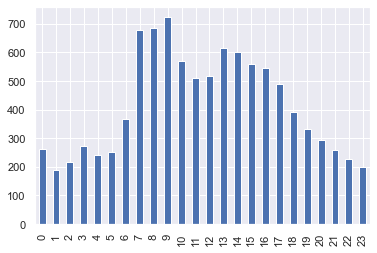

In [78]:
data.hour.value_counts().sort_index().plot.bar();

### Question 7 - Which streets has the more traffic during the rush hour

Can use the TRIP_PATH col to plot each path as a line on the map

In [68]:
# Rush hour at 9
rush_data = data[data.hour == 9]
rush_data.head()

,TRIP_ID,CALL_TYPE,TIMESTAMP,TRIP_PATH,START_LOC,END_LOC,week_day,hour
937,1372669784620000455,OTHER,1372669784,"[(41.166252, -8.607528), (41.165748, -8.608149...","(41.166252, -8.607528)","(41.164875, -8.608536)",Monday,9
947,1372669436620000285,STAND_BASED,1372669436,"[(41.145606, -8.610813), (41.145777, -8.610813...","(41.145606, -8.610813)","(41.149242, -8.627157)",Monday,9
956,1372669271620000653,STAND_BASED,1372669271,"[(41.15772, -8.628399)]","(41.15772, -8.628399)","(41.15772, -8.628399)",Monday,9
965,1372669911620000455,OTHER,1372669911,"[(41.164857, -8.608527), (41.16474, -8.608509)...","(41.164857, -8.608527)","(41.155362, -8.610237)",Monday,9
972,1372669864620000050,CENTRAL_BASED,1372669864,"[(41.155866, -8.643798), (41.156811, -8.643591...","(41.155866, -8.643798)","(41.148882, -8.648964)",Monday,9


In [77]:
coords = rush_data.TRIP_PATH.iloc[1]
rush_map = folium.Map(location = [41.15, -8.62], zoom_start=14)
for coords in rush_data.TRIP_PATH:  
    folium.PolyLine(coords, color='red', opacity=0.05, weight=2).add_to(rush_map)
rush_map